<a href="https://colab.research.google.com/github/dnasywa/Projects/blob/main/Default%20Loan%20EWS/Proxy%20I%20%26%20Proxy%20II.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Info Umum**

## **Get Info Proxy 1 (.xlsx)**

In [ ]:
import pandas as pd

In [ ]:
def get_info_proxy_1(tahun):
  # fetch the table from online spreadsheet
  url_proxy = "https://docs.google.com/spreadsheets/d/1UUwJayFLl1lU4Yek7Hdah4UxiBPa-f5c9q2LPodM4xE/gviz/tq?tqx=out:csv&sheet=inf_umum"
  data_proxy = pd.read_csv(url_proxy)

  # # drop unnamed columns
  # for (columnName, columnData) in data_proxy.items():
  #   if columnName.startswith('Unnamed:'):
  #     data_proxy = data_proxy.drop(columns=columnName)

  # filter out the "non this year" data
  data_proxy = data_proxy[data_proxy['Year'] == tahun]

  # set province column as index and drop the unused
  data_proxy = data_proxy.set_index(data_proxy['Cities'])
  data_proxy = data_proxy.drop(columns='Cities')

  return data_proxy

In [ ]:
get_info_proxy_1(2022).head(5)

,Year,Individual Risk,Contagion Risk,Final Cluster
Cities,,,,
KAB. ACEH BARAT,2022,Low Risk,Low Risk,Kuadran IV
KAB. ACEH BARAT DAYA,2022,High Risk,Low Risk,Kuadran II
KAB. ACEH BESAR,2022,High Risk,Low Risk,Kuadran II
KAB. ACEH GAYO LUES,2022,Low Risk,Low Risk,Kuadran IV
KAB. ACEH JAYA,2022,Low Risk,Low Risk,Kuadran IV


## **Get Daftar Daerah**

In [ ]:
import pandas as pd

In [ ]:
# def get_daftar_daerah():
#   info_umum = get_info_proxy_1(2018)
#   daftar_daerah = pd.DataFrame(info_umum.index.sort_values())

#   return daftar_daerah

In [ ]:
# get_daftar_daerah()

,Cities
0,KAB. ACEH BARAT
1,KAB. ACEH BARAT DAYA
2,KAB. ACEH BESAR
3,KAB. ACEH GAYO LUES
4,KAB. ACEH JAYA
...,...
537,PROV. SULAWESI TENGGARA
538,PROV. SULAWESI UTARA
539,PROV. SUMATERA BARAT
540,PROV. SUMATERA SELATAN


In [ ]:
def get_daftar_daerah(filter):
  url_umum = f'https://docs.google.com/spreadsheets/d/1SxV51nziTy5r6cMLjcM4L2-gpWS3rxU1/gviz/tq?tqx=out:csv&sheet=inf_umum'
  info_umum = pd.read_csv(url_umum)

  # drop null rows in "daerah" column
  info_umum = info_umum.dropna(subset=['daerah'])

  if filter == 'Provinsi':
    info_umum = info_umum[info_umum['daerah'].str.startswith('PROV.')]
  elif filter == 'Kabupaten':
    info_umum = info_umum[info_umum['daerah'].str.startswith('KAB.')]
  elif filter == 'Kota':
    info_umum = info_umum[info_umum['daerah'].str.startswith('KOTA ')]

  daftar_daerah = info_umum['daerah']
  daftar_daerah = pd.DataFrame(daftar_daerah.sort_values())
  daftar_daerah = daftar_daerah.reset_index()
  daftar_daerah = daftar_daerah.drop(columns='index')

  return daftar_daerah

In [ ]:
get_daftar_daerah('Kota')

,daerah
0,KOTA AMBON
1,KOTA BALIKPAPAN
2,KOTA BANDA ACEH
3,KOTA BANDAR LAMPUNG
4,KOTA BANDUNG
...,...
88,KOTA TERNATE
89,KOTA TIDORE KEPULAUAN
90,KOTA TOMOHON
91,KOTA TUAL


## **Get Info Adm (.csv)**

In [ ]:
def get_info_adm():
  info_adm = pd.read_csv('/content/IDN_adm1.csv')
  adm_fix = info_adm['NAME_1']
  adm_fix = 'PROV. ' + adm_fix.str.upper()
  adm_fix = adm_fix.replace({
    'PROV. BANGKA-BELITUNG': 'PROV. KEP. BABEL',
    'PROV. IRIAN JAYA BARAT': 'PROV. PAPUA BARAT',
    'PROV. JAKARTA RAYA': 'PROV. DKI JAKARTA',
    'PROV. NUSA TENGGARA BARAT': 'PROV. NTB',
    "PROV. NUSA TENGGARA TIMUR": "PROV. NTT",
    "PROV. YOGYAKARTA": "PROV. DIY"
  })

  return adm_fix

In [ ]:
get_info_adm().head(5)

0          PROV. ACEH
1          PROV. BALI
2    PROV. KEP. BABEL
3        PROV. BANTEN
4      PROV. BENGKULU
Name: NAME_1, dtype: object

## **Get Info Geo (.shx)**

Shapefile dalam format shx kadang tidak terbaca dan membutuhkan beberapa kali iterasi running untuk dapat terbaca seluruhnya


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import geopandas as gpd
import pandas as pd

In [ ]:
# Read shapefiles
# provinsi = gpd.read_file("/content/BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shx")

ERROR:fiona._env:Error in fread() reading object of size 3290872 at offset 75460244 from .shp file
ERROR:fiona._env:Error in fread() reading object of size 3311892 at offset 78751116 from .shp file
ERROR:fiona._env:Error in fread() reading object of size 1444008 at offset 82063008 from .shp file
ERROR:fiona._env:Error in fread() reading object of size 330828 at offset 83507016 from .shp file
ERROR:fiona._env:Error in fread() reading object of size 2233276 at offset 83837844 from .shp file


In [ ]:
# Read shapefiles
provinsi = gpd.read_file("/content/drive/MyDrive/MSIB - Kemenkeu/BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shx")

In [ ]:
# Read shapefiles
kabkota = gpd.read_file('/content/drive/MyDrive/MSIB - Kemenkeu/KabKot_Indonesia.shx')

In [ ]:
provinsi

,geometry
0,"MULTIPOLYGON Z (((97.39178 2.03748 0.00003, 97..."
1,"MULTIPOLYGON Z (((115.12509 -8.84761 0.00003, ..."
2,"MULTIPOLYGON Z (((105.54977 -6.99566 0.00003, ..."
3,"MULTIPOLYGON Z (((102.38616 -5.47144 0.00003, ..."
4,"MULTIPOLYGON Z (((110.81980 -8.20358 0.00003, ..."
5,"MULTIPOLYGON Z (((106.87677 -6.10030 0.00003, ..."
6,"MULTIPOLYGON Z (((121.42536 0.41243 0.00003, 1..."
7,"MULTIPOLYGON Z (((104.40714 -0.86371 0.00003, ..."
8,"MULTIPOLYGON Z (((108.68501 -6.76990 0.00003, ..."
9,"MULTIPOLYGON Z (((108.88353 -7.74846 0.00003, ..."


In [ ]:
kabkota

,geometry
0,"MULTIPOLYGON (((10760708.899 234491.422, 10760..."
1,"MULTIPOLYGON (((10842196.924 225437.205, 10842..."
2,"MULTIPOLYGON (((10864182.403 310592.848, 10864..."
3,"POLYGON ((10889785.686 414901.335, 10889469.31..."
4,"MULTIPOLYGON (((10906602.357 504343.576, 10906..."
...,...
519,"POLYGON ((15295898.656 -330341.115, 15296177.2..."
520,"POLYGON ((15149885.991 -415455.293, 15151022.7..."
521,"POLYGON ((15173918.075 -322054.731, 15174273.6..."
522,"POLYGON ((15192928.135 -444021.090, 15194427.1..."


In [ ]:
crs = 'EPSG:4326'

# gdf_provinsi = provinsi.set_crs(crs)
# gdf_kabupaten = kabkota.set_crs(crs)

gdf_provinsi = provinsi.copy()
gdf_kabupaten = kabkota.copy()

In [ ]:
crs_provinsi = gdf_provinsi.crs
crs_kabupaten = gdf_kabupaten.crs
print(crs_provinsi)
print(crs_kabupaten)

EPSG:4326
EPSG:4326


In [ ]:
gdf_provinsi = gdf_provinsi.reset_index(drop=True)
gdf_kabupaten = gdf_kabupaten.reset_index(drop=True)

In [ ]:
gdf_gabungan = pd.concat([gdf_provinsi, gdf_kabupaten], ignore_index=True)

In [ ]:
provinsi.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 34 entries, 0 to 33
Data columns (total 1 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   geometry  34 non-null     geometry
dtypes: geometry(1)
memory usage: 400.0 bytes


In [ ]:
# Merge/Combine multiple shapefiles into one
finalboss = gpd.pd.concat([provinsi, kabkota])

In [ ]:
finalboss

,geometry
0,"MULTIPOLYGON Z (((97.392 2.037 0.000, 97.391 2..."
1,"MULTIPOLYGON Z (((115.125 -8.848 0.000, 115.12..."
2,"MULTIPOLYGON Z (((105.550 -6.996 0.000, 105.55..."
3,"MULTIPOLYGON Z (((102.386 -5.471 0.000, 102.38..."
4,"MULTIPOLYGON Z (((110.820 -8.204 0.000, 110.82..."
...,...
519,"POLYGON ((15295898.656 -330341.115, 15296177.2..."
520,"POLYGON ((15149885.991 -415455.293, 15151022.7..."
521,"POLYGON ((15173918.075 -322054.731, 15174273.6..."
522,"POLYGON ((15192928.135 -444021.090, 15194427.1..."


In [ ]:
#Export merged geodataframe into shapefile
gdf_gabungan.to_file("/content/gdf_gabungan.shp")

In [ ]:
final = gpd.read_file('/content/finalboss.shx')

In [ ]:
final

,FID,geometry
0,0,"MULTIPOLYGON Z (((97.39178 2.03748 0.00003, 97..."
1,1,"MULTIPOLYGON Z (((115.12509 -8.84761 0.00003, ..."
2,2,"MULTIPOLYGON Z (((105.54977 -6.99566 0.00003, ..."
3,3,"MULTIPOLYGON Z (((102.38616 -5.47144 0.00003, ..."
4,4,"MULTIPOLYGON Z (((110.81980 -8.20358 0.00003, ..."
...,...,...
544,544,"MULTIPOLYGON Z (((105.27466 -5.15933 0.00000, ..."
545,545,"POLYGON Z ((111.18203 -7.71237 0.00000, 111.18..."
546,546,"POLYGON Z ((109.93000 -7.19465 0.00000, 109.93..."
547,547,"POLYGON Z ((139.96223 -3.60980 0.00000, 139.96..."


In [ ]:
import geopandas as gpd

In [ ]:
shapefile_path = "/content/Batas_Wilayah_KelurahanDesa_10K_AR.shp"
info_geo = gpd.read_file(shapefile_path)
info_geo

In [ ]:
def get_info_geo(info_proxy, info_adm):
  shapefile_path = "/content/IDN_adm1.shx"
  info_geo = gpd.read_file(shapefile_path)
  info_geo = info_geo.set_index(info_adm)
  info_geo = info_geo.merge(info_proxy, left_on='NAME_1', right_on='Provinces ')

  # adding back the province column
  info_geo = info_geo.assign(Province = info_adm)

  return info_geo

In [ ]:
get_info_geo(get_info_proxy_1(2018), get_info_adm())

,geometry,Year,Individual Risk,Contagion Risk,Final Cluster,Province
0,"MULTIPOLYGON (((97.38493 1.97713, 97.38396 1.9...",2018,High Risk,Low Risk,Kuadran II,PROV. ACEH
1,"MULTIPOLYGON (((115.62988 -8.77599, 115.63037 ...",2018,Low Risk,Low Risk,Kuadran IV,PROV. BALI
2,"MULTIPOLYGON (((108.06951 -3.80305, 108.06826 ...",2018,Low Risk,Low Risk,Kuadran IV,PROV. KEP. BABEL
3,"MULTIPOLYGON (((105.54861 -6.99472, 105.54889 ...",2018,High Risk,High Risk,Kuadran I,PROV. BANTEN
4,"MULTIPOLYGON (((102.38627 -5.47112, 102.38682 ...",2018,Low Risk,Low Risk,Kuadran IV,PROV. BENGKULU
5,"MULTIPOLYGON (((122.12139 0.40583, 122.12167 0...",2018,High Risk,Low Risk,Kuadran II,PROV. GORONTALO
6,"MULTIPOLYGON (((133.50668 -4.32504, 133.50676 ...",2018,Low Risk,Low Risk,Kuadran IV,PROV. PAPUA BARAT
7,"MULTIPOLYGON (((106.73338 -6.09776, 106.73373 ...",2018,High Risk,High Risk,Kuadran I,PROV. DKI JAKARTA
8,"MULTIPOLYGON (((104.21628 -1.06326, 104.21578 ...",2018,High Risk,High Risk,Kuadran I,PROV. JAMBI
9,"MULTIPOLYGON (((107.85297 -7.73661, 107.85330 ...",2018,High Risk,High Risk,Kuadran I,PROV. JAWA BARAT


Silakan run secara berkala hingga tidak terbaca error sama sekali

## **Get Info Proxy 2**

In [ ]:
def get_info_proxy_2():
  # fetch the table from online spreadsheet
  url_proxy = "https://docs.google.com/spreadsheets/d/1WA4NocpklIeakdIFQFAEV2FBItGCNiR7E1HS2QKN_bc/gviz/tq?tqx=out:csv&sheet=Final_Data"

  data = pd.read_csv(url_proxy)

  # drop out unwanted columns
  data_proxy = data[['Provinces ', 'Proxy_Variable_II', 'Quartile Classification']].copy()

  # set province column as index and drop the unused
  data_proxy = data_proxy.set_index(data_proxy['Provinces '])
  data_proxy = data_proxy.drop(columns='Provinces ')

  # rename the column
  data_proxy = data_proxy.rename(columns={
      'Provinces ' : 'Province',
      'Proxy_Variable_II' : 'Proxy Var II',
      'Quartile Classification' : 'Class'
      })

  return data_proxy

In [ ]:
get_info_proxy_2()

,Proxy Var II,Class
Provinces,,
PROV. ACEH,1.668586,KELOMPOK 1
PROV. BALI,1.115610,KELOMPOK 1
PROV. BANTEN,0.741580,KELOMPOK 3
PROV. BENGKULU,0.567717,KELOMPOK 5
PROV. DIY,1.098576,KELOMPOK 2
PROV. DKI JAKARTA,1.120614,KELOMPOK 1
PROV. GORONTALO,0.539373,KELOMPOK 5
PROV. JAMBI,1.090813,KELOMPOK 2
PROV. JAWA BARAT,0.603831,KELOMPOK 5


# **Proxy 1**

## **Plot Viz - Manual**

In [ ]:
import matplotlib.pyplot as plt

<ipython-input-10-ef894967c583>:7: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for (columnName, columnData) in data_proxy.iteritems():
<ipython-input-10-ef894967c583>:7: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for (columnName, columnData) in data_proxy.iteritems():


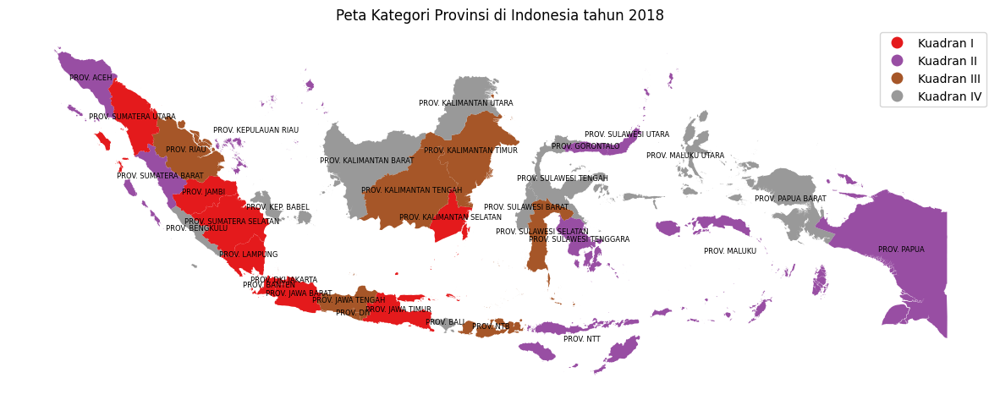

In [ ]:
fig, ax = plt.subplots(figsize=(15, 10))
get_info_geo(get_info_proxy_1(2018), get_info_adm()).plot(column='Final Cluster', cmap='Set1', ax=ax, legend=True)
ax.set_title('Peta Kategori Provinsi di Indonesia tahun 2018')

# Menambahkan label provinsi
for idx, row in get_info_geo(get_info_proxy_1(2018), get_info_adm()).iterrows():
    x, y = row.geometry.centroid.xy
    ax.annotate(text=row['Province'], xy=(x[0], y[0]), horizontalalignment='center', fontsize=6)

plt.axis('off')
plt.show()

## **Plot Viz - Automation**

In [ ]:
def generate_map_1(tahun):
  info_proxy = get_info_proxy_1(tahun)
  info_adm = get_info_adm()
  info_geo = get_info_geo(info_proxy, info_adm)

  fig, ax = plt.subplots(figsize=(15, 10))
  info_geo.plot(column='Final Cluster', cmap='rainbow_r', ax=ax, legend=True,
                edgecolor='white', linewidth=1)
  ax.set_title(f'Peta Proxy I Provinsi di Indonesia tahun {tahun}')

  # adding province label
  for idx, row in info_geo.iterrows():
    x, y = row.geometry.centroid.xy
    ax.annotate(text=row['Province'], xy=(x[0], y[0]), horizontalalignment='center', fontsize=6, fontweight='bold')

  plt.axis('off')
  plt.show()

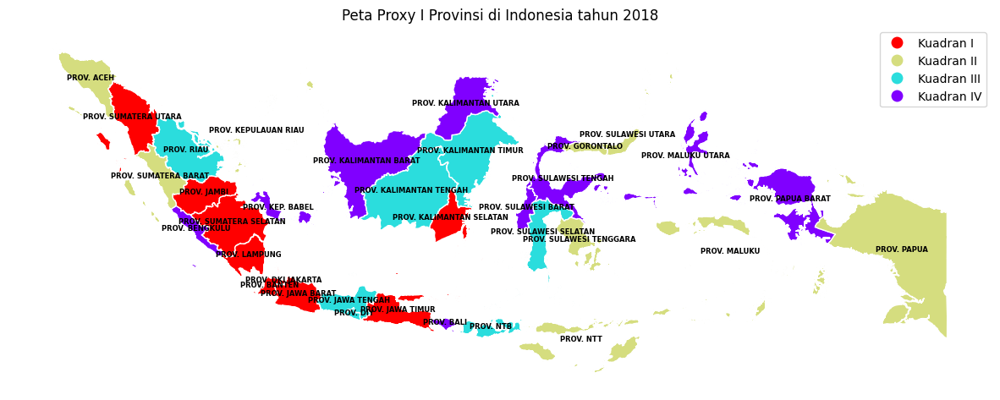

In [ ]:
generate_map_1(2018)

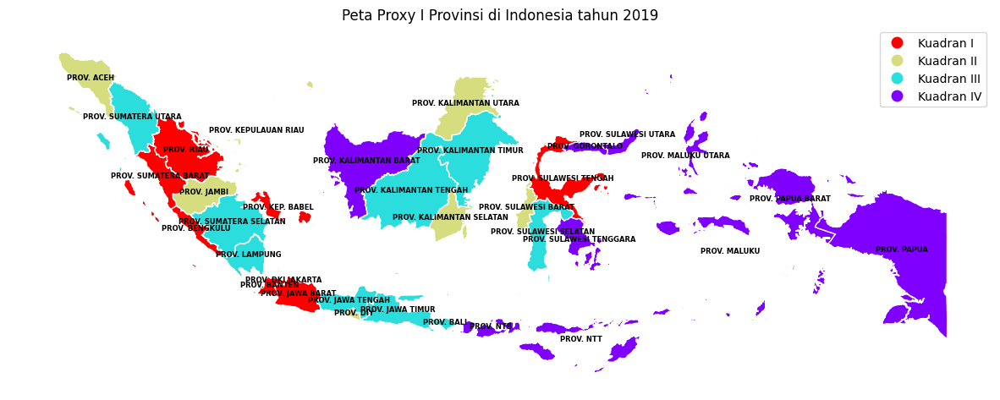

In [ ]:
generate_map_1(2019)

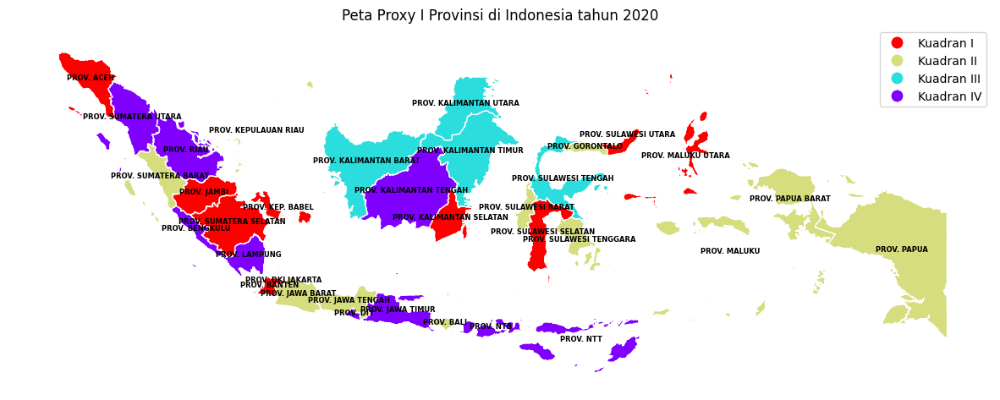

In [ ]:
generate_map_1(2020)

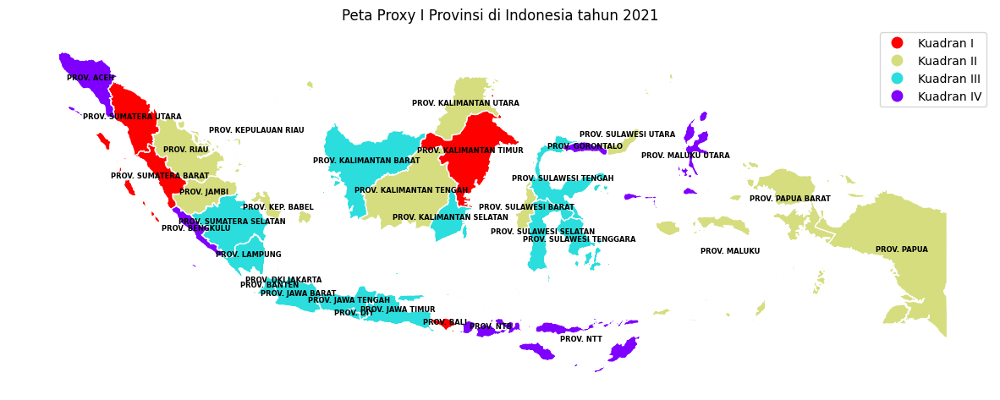

In [ ]:
generate_map_1(2021)

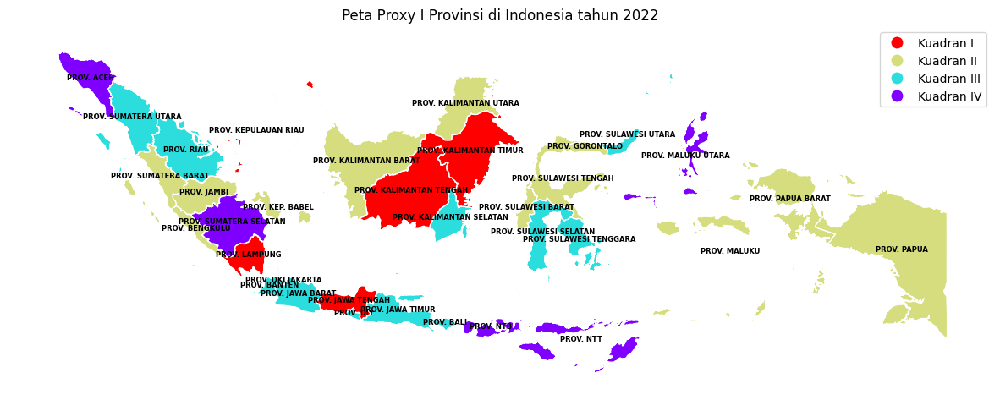

In [ ]:
generate_map_1(2022)

# **Markov Model**

## **Get Proxy Value 1**

In [ ]:
import pandas as pd

**PASTIKAN RENTANG TAHUN YANG MAU DIPAKAI YAA!**

In [ ]:
# def get_proxy_val_1(city): -- UNUSED
#   url_value = f'https://docs.google.com/spreadsheets/d/1UUwJayFLl1lU4Yek7Hdah4UxiBPa-f5c9q2LPodM4xE/gviz/tq?tqx=out:csv&sheet=TS_PROVAR1'
#   info_value = pd.read_csv(url_value)

#   data_prov = info_value[info_value['Cities'] == city]
#   data_prov = data_prov.drop(columns='Cities')
#   data_prov = data_prov.set_index(data_prov['Year'])
#   data_prov = data_prov.drop(columns='Year')

#   # # for advanced calculation
#   # data_fix = data_prov.copy()
#   # data_fix = data_fix[data_fix.index <= 2021]

#   return data_prov

In [ ]:
def get_proxy_val_1(daerah):
  if daerah.startswith('PROV. '):
    url_value = f'https://docs.google.com/spreadsheets/d/1xTfwAoEl5vXlO306mb_aPCh8IJVbax58IoncjckFg-U/gviz/tq?tqx=out:csv&sheet=TS_PROVAR1'
  elif daerah.startswith('KOTA '):
    url_value = f'https://docs.google.com/spreadsheets/d/1AqNV_drWwd7-nITfJZJL5Qm8YIDRF5HqXeGIb6j1Ogk/gviz/tq?tqx=out:csv&sheet=TS_PROVAR1'
  elif daerah.startswith('KAB. '):
    url_value = f'https://docs.google.com/spreadsheets/d/17UvHYbMtSCYpUxv-Mt1Gjlf7B0cmseBQUcr9AKGgtjY/gviz/tq?tqx=out:csv&sheet=TS_PROVAR1'

  info_value = pd.read_csv(url_value)

  data_daerah = info_value[info_value['Daerah'] == daerah]
  data_daerah = data_daerah.set_index(data_daerah['Tahun'])
  data_daerah = data_daerah.drop(columns=['Tahun', 'Daerah', 'Kode'])

  # # for advanced calculation
  # data_fix = data_daerah.copy()
  # data_fix = data_fix[data_fix.index <= 2021]

  return data_daerah

In [ ]:
get_proxy_val_1("PROV. KEP. RIAU")

,Proxy_Variable_1
Tahun,
2013,0.816042
2014,0.412316
2015,0.517801
2016,0.618753
2017,0.648150
2018,0.476288
2019,0.498703
2020,0.672941
2021,0.469761


## **MS-AR Model**

In [ ]:
import pandas as pd
import statsmodels.api as sm

In [ ]:
msar = sm.tsa.MarkovAutoregression(get_proxy_val_1("PROV. DIY"), k_regimes=2, order=1, switching_ar=True)

### **Summary**

In [ ]:
result = msar.fit()
print(result.summary())

                         Markov Switching Model Results                         
Dep. Variable:         Proxy_Variable_1   No. Observations:                    9
Model:             MarkovAutoregression   Log Likelihood                  12.749
Date:                  Tue, 11 Jun 2024   AIC                            -11.498
Time:                          06:50:31   BIC                            -10.118
Sample:                               0   HQIC                           -14.478
                                    - 9                                         
Covariance Type:                 approx                                         
                             Regime 0 parameters                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.3968    681.328      0.001      1.000   -1334.981    1335.775
ar.L1         -0.1459   6791.853  -2

### **Parameter**

In [ ]:
params = result.params
params

p[0->0]     1.060270e-01
p[1->0]     3.027158e-10
const[0]    3.968226e-01
const[1]    4.375898e-01
sigma2      3.690187e-03
ar.L1[0]   -1.458972e-01
ar.L1[1]   -3.448251e-01
dtype: float64

### **Get Regime Trans**

In [ ]:
def get_regime_trans(model, result):
  # record the regime transition probabilities
  trans_mat = model.regime_transition_matrix(result.params)
  trans_mat = trans_mat.reshape(trans_mat.shape[0], trans_mat.shape[1])
  trans_mat = pd.DataFrame(trans_mat.T,
                                   columns=['Regime_1', 'Regime_2'],
                                   index=['Regime 1','Regime 2'])

  return trans_mat

In [ ]:
transition_matrix = msar.regime_transition_matrix(result.params)
transition_matrix

array([[[1.06026998e-01],
        [3.02715776e-10]],

       [[8.93973002e-01],
        [1.00000000e+00]]])

In [ ]:
transition_matrix = transition_matrix.reshape(transition_matrix.shape[0], transition_matrix.shape[1])

In [ ]:
pd.DataFrame(transition_matrix.T, columns=['Regime_1', 'Regime_2'],index=['Regime 1','Regime 2'] )

,Regime_1,Regime_2
Regime 1,1.060270e-01,0.893973
Regime 2,3.027158e-10,1.000000


In [ ]:
transition_matrix[0][0]

0.10602699778758388

### **Duration**

In [ ]:
risk_durations = result.expected_durations
print("Expected Durations of Risk States:")
print(risk_durations)

Expected Durations of Risk States:
[1.11860201e+00 3.30342914e+09]


### **Assign Values - Automation**

In [ ]:
def assign_values(data, transition_mat, risk_dur):
  # final_data = pd.concat([data, pd.DataFrame({ # VERSI BARU YAAA - ENG
  #     'High - High': transition_mat.loc['Regime 1']['Regime_1'],
  #     'High - Low': transition_mat.loc['Regime 1']['Regime_2'],
  #     'Low - High': transition_mat.loc['Regime 2']['Regime_1'],
  #     'Low - Low': transition_mat.loc['Regime 2']['Regime_2'],
  #     'Duration (High)': risk_dur[0],
  #     'Duration (Low)': risk_dur[1]
  #   }, index=[0])], ignore_index=True)

  final_data = pd.concat([data, pd.DataFrame({ # VERSI LAMA BANGET INI - INDO
      'Low - Low': transition_mat.loc['Regime 1']['Regime_1'],
      'Low - High': transition_mat.loc['Regime 1']['Regime_2'],
      'High - Low': transition_mat.loc['Regime 2']['Regime_1'],
      'High - High': transition_mat.loc['Regime 2']['Regime_2'],
      'Duration (Low)': risk_dur[0],
      'Duration (High)': risk_dur[1]
    }, index=[0])], ignore_index=True)
  return final_data

## **Automation: MS-AR Model**

In [ ]:
import pandas as pd
import numpy as np
import statsmodels.api as sm

In [ ]:
# def generate_msar():

#   import warnings

#   # Filter out specific warnings
#   with warnings.catch_warnings():
#     warnings.simplefilter(action='ignore', category=FutureWarning)
#     warnings.simplefilter(action='ignore', category=RuntimeWarning)
#     warnings.simplefilter(action='ignore', category=DeprecationWarning)

#   # list of cities
#   data_daerah = get_daftar_daerah()

#   # initialize final dataframe
#   final_df = pd.DataFrame(columns=['Low - Low', 'Low - High', 'High - Low', 'High - High', 'Duration (Low)', 'Duration (High)'])

#   daerah_list = []
#   param_list = []

#   for index, row in data_daerah.iterrows():
#     nama_daerah = row.iloc[0]

#     # get timeseries proxy 1 for each daerah
#     info_daerah = get_proxy_val_1(nama_daerah)

#     # build the MS-AR model for 2 regime (low-high risk)
#     model = sm.tsa.MarkovAutoregression(info_daerah, k_regimes=2, order=1, switching_ar=True)

#     result = model.fit()
#     param = result.params

#     # record the regime transition probabilities
#     transition_matrix = get_regime_trans(model, result)

#     # record the regime duration
#     risk_durations = result.expected_durations

#     while np.isnan(risk_durations[0]) or risk_durations[0] > 10 or risk_durations[1] > 10:
#       param = np.random.rand(7)
#       result = model.fit(start_params=param)
#       risk_durations = result.expected_durations

#     daerah_list.append(nama_daerah)
#     param_list.append(param)

#     # merge the dataset
#     final_df = assign_values(final_df, transition_matrix, risk_durations)
#   final_df['Cities'] = data_daerah

#   return daerah_list, param_list, final_df

In [ ]:
get_daftar_daerah('Kabupaten')

,daerah
0,KAB. ACEH BARAT
1,KAB. ACEH BARAT DAYA
2,KAB. ACEH BESAR
3,KAB. ACEH GAYO LUES
4,KAB. ACEH JAYA
...,...
410,KAB. WONDAMA
411,KAB. WONOGIRI
412,KAB. WONOSOBO
413,KAB. YAHUKIMO


In [ ]:
get_proxy_val_1('KAB. ACEH BARAT')

,Proxy_Variable_1
Tahun,
2013,0.631808
2014,0.089189
2015,0.159813
2016,0.240455
2017,0.165489
2018,0.247564
2019,0.186621
2020,0.322034
2021,0.371380


In [ ]:
def generate_msar(filter):

  import warnings
  warnings.filterwarnings("ignore")

  # list of cities
  data_daerah = get_daftar_daerah(filter)

  # initialize final dataframe
  final_df = pd.DataFrame()

  daerah_list = []
  param_list = []

  for index, row in data_daerah.iterrows():
    nama_daerah = row.iloc[0]

    # get timeseries proxy 1 for each daerah
    info_daerah = get_proxy_val_1(nama_daerah)

    # build the MS-AR model for 2 regime (low-high risk)
    model = sm.tsa.MarkovAutoregression(info_daerah, k_regimes=2, order=1, switching_ar=True)

    result = model.fit()
    param = result.params

    # record the regime transition probabilities
    transition_matrix = get_regime_trans(model, result)

    # record the regime duration
    risk_durations = result.expected_durations

    while np.isnan(risk_durations[0]) or risk_durations[0] > 10 or risk_durations[1] > 10:
      param = np.random.rand(7)
      result = model.fit(start_params=param)
      risk_durations = result.expected_durations

    daerah_list.append(nama_daerah)
    param_list.append(param)

    print(nama_daerah)

    # merge the dataset
    final_df = assign_values(final_df, transition_matrix, risk_durations)
  final_df['Daerah'] = data_daerah

  return daerah_list, param_list, final_df

In [ ]:
msar_cities, msar_params, msar_risk = generate_msar('Kota')

KOTA AMBON
KOTA BALIKPAPAN
KOTA BANDA ACEH
KOTA BANDAR LAMPUNG
KOTA BANDUNG
KOTA BANJAR
KOTA BANJARBARU
KOTA BANJARMASIN
KOTA BATAM
KOTA BATU
KOTA BAU-BAU
KOTA BEKASI
KOTA BENGKULU
KOTA BIMA
KOTA BINJAI
KOTA BITUNG
KOTA BLITAR
KOTA BOGOR
KOTA BONTANG
KOTA BUKITTINGGI
KOTA CILEGON
KOTA CIMAHI
KOTA CIREBON
KOTA DENPASAR
KOTA DEPOK
KOTA DUMAI
KOTA GORONTALO
KOTA GUNUNGSITOLI
KOTA JAMBI
KOTA JAYAPURA
KOTA KEDIRI
KOTA KENDARI
KOTA KOTAMOBAGU
KOTA KUPANG
KOTA LANGSA
KOTA LHOKSEUMAWE
KOTA LUBUK LINGGAU
KOTA MADIUN
KOTA MAGELANG
KOTA MAKASSAR
KOTA MALANG
KOTA MANADO
KOTA MATARAM
KOTA MEDAN
KOTA METRO
KOTA MOJOKERTO
KOTA PADANG
KOTA PADANG PANJANG
KOTA PADANG SIDEMPUAN
KOTA PAGARALAM
KOTA PALANGKARAYA
KOTA PALEMBANG
KOTA PALOPO
KOTA PALU
KOTA PANGKALPINANG
KOTA PARE-PARE
KOTA PARIAMAN
KOTA PASURUAN
KOTA PAYAKUMBUH
KOTA PEKALONGAN
KOTA PEKANBARU
KOTA PEMATANG SIANTAR
KOTA PONTIANAK
KOTA PRABUMULIH
KOTA PROBOLINGGO
KOTA SABANG
KOTA SALATIGA
KOTA SAMARINDA
KOTA SAWAHLUNTO
KOTA SEMARANG
KOTA SERANG

In [ ]:
msar_risk.to_excel("[NEW 10] Model MS-AR Tingkat Kota 2022.xlsx")

In [ ]:
# print the initial params for each regency
for i in range(len(msar_cities)):
  print(f"{msar_cities[i]}, Parameter: {msar_params[i]}")

KOTA AMBON, Parameter: [0.45257116 0.06081854 0.0522773  0.77872291 0.24996085 0.73286613
 0.9135373 ]
KOTA BALIKPAPAN, Parameter: p[0->0]     9.765316e-07
p[1->0]     3.605185e-01
const[0]    6.218265e-01
const[1]    7.647422e-01
sigma2      9.377170e-03
ar.L1[0]   -6.535744e-01
ar.L1[1]    1.468424e-01
dtype: float64
KOTA BANDA ACEH, Parameter: p[0->0]     0.829417
p[1->0]     0.461026
const[0]    0.292576
const[1]    0.516776
sigma2      0.008308
ar.L1[0]   -0.436704
ar.L1[1]    0.581563
dtype: float64
KOTA BANDAR LAMPUNG, Parameter: p[0->0]     0.000000
p[1->0]     0.544238
const[0]    0.575787
const[1]    0.813799
sigma2      0.014895
ar.L1[0]    1.000000
ar.L1[1]    0.028200
dtype: float64
KOTA BANDUNG, Parameter: p[0->0]     0.701690
p[1->0]     0.696945
const[0]    0.440677
const[1]    0.795377
sigma2      0.000444
ar.L1[0]    0.231268
ar.L1[1]   -0.383587
dtype: float64
KOTA BANJAR, Parameter: p[0->0]     0.765392
p[1->0]     0.103759
const[0]    0.395501
const[1]    0.665308


In [ ]:
# print the initial params for each regency
for i in range(len(msar_cities)):
  print(f"{msar_cities[i]}, Parameter: {msar_params[i]}")

KAB. ACEH BARAT, Parameter: [0.32980304 0.21302555 0.56579363 0.09166278 0.2387438  0.6469912
 0.85764287]
KAB. ACEH BARAT DAYA, Parameter: p[0->0]     0.412154
p[1->0]     0.444994
const[0]    0.081678
const[1]    0.230415
sigma2      0.000969
ar.L1[0]    0.015692
ar.L1[1]   -0.209001
dtype: float64
KAB. ACEH BESAR, Parameter: [0.47001158 0.08474891 0.66737933 0.37853721 0.31752991 0.61492718
 0.92276949]
KAB. ACEH GAYO LUES, Parameter: p[0->0]     0.854764
p[1->0]     0.141853
const[0]    0.106843
const[1]    0.197002
sigma2      0.000828
ar.L1[0]    0.069404
ar.L1[1]   -0.135883
dtype: float64
KAB. ACEH JAYA, Parameter: p[0->0]     0.219224
p[1->0]     1.000000
const[0]    0.079531
const[1]    0.207553
sigma2      0.000454
ar.L1[0]   -0.323327
ar.L1[1]   -0.218990
dtype: float64
KAB. ACEH SELATAN, Parameter: p[0->0]     0.000000
p[1->0]     0.277247
const[0]    0.064546
const[1]    0.221971
sigma2      0.000774
ar.L1[0]    1.000000
ar.L1[1]   -0.322496
dtype: float64
KAB. ACEH SINGK

In [ ]:
# print the initial params for each province
for i in range(len(msar_cities)):
  print(f"Kota: {msar_cities[i]}, Paramenter: {msar_params[i]}")

Kota: PROV. ACEH, Paramenter: [0.53598631 0.72071227 0.98799195 0.67593205 0.48950784 0.67919091
 0.48435026]
Kota: PROV. BALI, Paramenter: p[0->0]     0.427578
p[1->0]     0.252996
const[0]    0.587651
const[1]    0.687876
sigma2      0.001316
ar.L1[0]   -1.000000
ar.L1[1]    0.921851
dtype: float64
Kota: PROV. BANTEN, Paramenter: p[0->0]     0.425601
p[1->0]     0.462693
const[0]    0.319820
const[1]    0.598282
sigma2      0.003480
ar.L1[0]    0.160688
ar.L1[1]   -1.000000
dtype: float64
Kota: PROV. BENGKULU, Paramenter: p[0->0]     3.439506e-15
p[1->0]     1.136904e-01
const[0]    1.922323e-01
const[1]    5.566947e-01
sigma2      2.750908e-03
ar.L1[0]   -4.485882e-01
ar.L1[1]   -6.008783e-01
dtype: float64
Kota: PROV. DIY, Paramenter: [0.89642296 0.25624971 0.23399518 0.49587328 0.68324326 0.02267849
 0.02886464]
Kota: PROV. DKI JAKARTA, Paramenter: p[0->0]     0.397385
p[1->0]     0.303413
const[0]    0.537086
const[1]    0.717325
sigma2      0.002016
ar.L1[0]   -1.000000
ar.L1[1]

## **Manual: MS-AR Model**

In [ ]:
import numpy as np

In [ ]:
# get timeseries proxy 1 for each daerah
info_daerah = get_proxy_val_1("KAB. SLEMAN")

In [ ]:
# build the MS-AR model for 2 regime (low-high risk)
model = sm.tsa.MarkovAutoregression(info_daerah, k_regimes=2, order=1, switching_ar=True)
result = model.fit(start_params=[0.66639568, 0.38141153, 0.87523209, 0.01597878, 0.60478426, 0.36620158, 0.22245285])
print(result.summary())

                         Markov Switching Model Results                         
Dep. Variable:         Proxy_Variable_I   No. Observations:                    9
Model:             MarkovAutoregression   Log Likelihood                   9.561
Date:                  Tue, 28 May 2024   AIC                             -5.121
Time:                          07:34:41   BIC                             -3.741
Sample:                               0   HQIC                            -8.101
                                    - 9                                         
Covariance Type:                 approx                                         
                             Regime 0 parameters                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7607      0.062     12.261      0.000       0.639       0.882
ar.L1         -0.2262      0.244    

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


In [ ]:
# record the regime transition probabilities
transition_matrix = get_regime_trans(model, result)
transition_matrix

,Regime_1,Regime_2
Regime 1,0.722081,0.277919
Regime 2,0.627818,0.372182


In [ ]:
# record the regime duration
risk_durations = result.expected_durations
risk_durations

array([nan, inf])

# **Proxy 2**

## **Plot Viz - Manual**

In [ ]:
import matplotlib.pyplot as plt

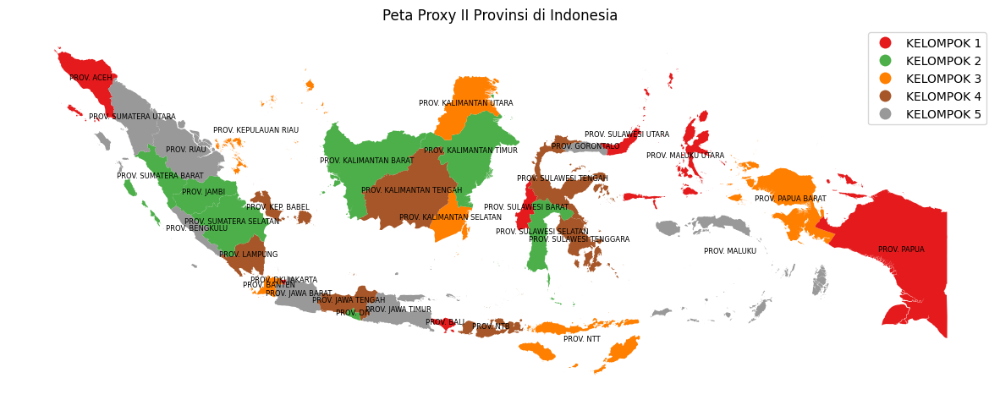

In [ ]:
fig, ax = plt.subplots(figsize=(15, 10))
get_info_geo(get_info_proxy_2(), get_info_adm()).plot(column='Class', cmap='Set1', ax=ax, legend=True)
ax.set_title('Peta Proxy II Provinsi di Indonesia')

# Menambahkan label provinsi
for idx, row in get_info_geo(get_info_proxy_2(), get_info_adm()).iterrows():
    x, y = row.geometry.centroid.xy
    ax.annotate(text=row['Province'], xy=(x[0], y[0]), horizontalalignment='center', fontsize=6)

plt.axis('off')
plt.show()

## **Plot Viz - Automation**

In [ ]:
def generate_map_2():
  info_proxy = get_info_proxy_2()
  info_adm = get_info_adm()
  info_geo = get_info_geo(info_proxy, info_adm)

  fig, ax = plt.subplots(figsize=(15, 10))
  info_geo.plot(column='Class', cmap='rainbow_r', ax=ax, legend=True,
                edgecolor='white', linewidth=1)
  ax.set_title(f'Peta Proxy II Provinsi di Indonesia')

  # adding province label
  for idx, row in info_geo.iterrows():
    x, y = row.geometry.centroid.xy
    ax.annotate(text=row['Province'], xy=(x[0], y[0]), horizontalalignment='center', fontsize=6, fontweight='bold')

  plt.axis('off')
  plt.show()

In [ ]:
generate_map_2()

## **MS-AR ARCHIEVE - PER 2022**

In [ ]:
def generate_msar():

  import warnings

  # Filter out specific warnings
  with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    warnings.simplefilter(action='ignore', category=DeprecationWarning)

  # list of provinces
  data_prov = get_daftar_provinsi()

  # initialize final dataframe
  final_df = pd.DataFrame(columns=['Low - Low', 'Low - High', 'High - Low', 'High - High', 'Duration (Low)', 'Duration (High)'])

  for index, row in data_prov.iterrows():
    province_name = row.iloc[0]

    # get timeseries proxy 1 for each daerah
    info_daerah = get_proxy_val_1(province_name)

    # build the MS-AR model for 2 regime (low-high risk)
    model = sm.tsa.MarkovAutoregression(info_daerah, k_regimes=2, order=1, switching_ar=True)

    print("INI PUNYA ", province_name)
    if(province_name == "PROV. ACEH"):
      params = [0.78798701, 0.25736654, 0.31676706, 0.76639702, 0.67977171, 0.71944158, 0.97153019]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. BALI"):
      params = [0.55570129, 0.40942915, 0.51918269, 0.67712654, 0.78567234, 0.1705129, 0.03745425]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. BANTEN"):
      params = [0.06643833, 0.59315117, 0.4180417, 0.501022, 0.50556594, 0.49754241, 0.99724255]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. BENGKULU"):
      params = [0.42643828, 0.41188649, 0.39343261, 0.20492616, 0.50950923, 0.44634508, 0.36536547]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. DIY"):
      params = [0.67007941, 0.48055351, 0.51549539, 0.01454451, 0.63981616, 0.75264926, 0.21083016]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. DKI JAKARTA"):
      params = [0.1503907, 0.52722579, 0.36485173, 0.19853657, 0.66723172, 0.91432968, 0.4990645]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. GORONTALO"):
      params = [0.25932176, 0.12016493, 0.72441948, 0.44090736, 0.09230553, 0.3104595, 0.02001685]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. JAMBI"):
      params = [0.6224328, 0.5821845, 0.4484018, 1.03158, 0.0249447, -0.587888, 0.83336711]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. JAWA BARAT"):
      params = [0.11158929, 0.29463646, 0.24590041, 0.93112757, 0.56951303, 0.93476642, 0.06847986]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. JAWA TENGAH"):
      params = [0.3819429, 0.9999999, 0.8030334, 0.8145258, 0.0014921, -0.6505082, 0.55215894]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. JAWA TIMUR"):
      params = [0.14167008, 0.8854168, 0.22196907, 0.00246273, 0.44126911, 0.80352373, 0.35825045]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KALIMANTAN BARAT"):
      params = [0.32294781, 0.30186575, 0.99066179, 0.37582177, 0.80351616, 0.4626547, 0.47245165]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KALIMANTAN SELATAN"):
      params = [0.35355688, 0.55957786, 0.58945588, 0.96694565, 0.23337962, 0.70974216, 0.63689472]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KALIMANTAN TENGAH"): # IDENTICAL RESULT with 2 parameter variations
      params = [0.08147892, 0.08366027, 0.1548042, 0.38030411, 0.38941795, 0.42753438, 0.85383892]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KALIMANTAN TIMUR"):
      params = [0.62307673, 0.34685017, 0.29813475, 0.34038807, 0.63044803, 0.01545346, 0.96682688]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KALIMANTAN UTARA"):
      params = [0.44340788, 0.39716517, 0.83501317, 0.60780021, 0.39210496, 0.3697196, 0.18385549]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KEP. BABEL"):
      params = [0.58497244, 0.94136756, 0.6910587, 0.71973111, 0.53854092, 0.33894817, 0.27662122]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KEPULAUAN RIAU"):
      params = [0.3819566, 1., 0.7072731, 0.8615733, 0.0104917, -0.3168891, 0.14010453]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. LAMPUNG"):
      # params = [0.3935894, 1., 0.5845945, 0.9134287, 0.08252, -0.2472015, 0.90938076]
      params = [0.15147848, 0.24726119, 0.63725468, 0.61477558, 0.01022794, 0.77117736, 0.22212266]
      result = model.fit(start_params=params)
      print(result.summary())
    elif(province_name == "PROV. MALUKU"):
      params = [0.67470542, 0.81679817, 0.52141688, 0.24783891, 0.77397044, 0.72652904, 0.62745706]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. MALUKU UTARA"):
      params = [0.72703639, 0.66105667, 0.78037285, 0.5722652, 0.48394686, 0.25786264, 0.01528575]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. NTB"):
      params = [0.48617827, 0.93050974, 0.72653128, 0.70086652, 0.44734709, 0.78251717, 0.62534134]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. NTT"):
      params = [0.53849775, 0.55919825, 0.025298, 0.27347673, 0.40653151, 0.00264601, 0.5763145 ]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. PAPUA"):
      params = [0.83106672, 0.41981951, 0.12645594, 0.17217458, 0.37569996, 0.4190998, 0.72972978]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. PAPUA BARAT"): # SIMILIAR RESULT with 2 parameter variations
      params = [0.81091034, 0.47481447, 0.29350758, 0.86931112, 0.98119699, 0.50895614, 0.12362598]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. RIAU"):
      params = [0.7192209, 1., 0.5452465, 0.8571706, 0.0138237, -0.0686769, 0.76244226]
      result = model.fit(start_params=params)
      print(result.summary())
    elif(province_name == "PROV. SULAWESI BARAT"):
      params = [0.31577058, 0.3723143, 0.06077501, 0.54183108, 0.14685607, 0.50639725, 0.90780722]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SULAWESI SELATAN"):
      params = [0.1301814, 0.7453784, 0.8544026, 0.8602042, 0.2230649, -0.5684321, 0.0940125]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SULAWESI TENGAH"):
      params = [6.16000000e-08, 2.83156300e-01, 4.81678600e-01, 8.18321300e-01, 8.91918000e-02, -2.38900000e-02, 1.58086222e-01]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SULAWESI TENGGARA"):
      params = [0.58454944, 0.35369565, 0.19172837, 0.92822761, 0.47400534, 0.63267362, 0.16267322]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SULAWESI UTARA"):
      params = [0.6174826, 0.37941987, 0.92765571, 0.3002177, 0.71243929, 0.27746008, 0.17627178]
      # params = [0.90147437, 0.35761049, 0.70831564, 0.62523848, 0.74150514, 0.36352175, 0.07976713]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SUMATERA BARAT"):
      params = [0.55295814, 0.28459922, 0.28421974, 0.97552535, 0.35625682, 0.19910219, 0.57480396]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SUMATERA SELATAN"):
      params = [0.88071886, 0.29747407, 0.70593234, 0.69807636, 0.04629802, 0.00712035, 0.11124803]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SUMATERA UTARA"):
      params = [0.001459,  0.9999834, 0.6679728, 0.6683046, 0.0917389, -0.9288482, 0.74246302]
      result = model.fit(start_params=params)
    else:
      result = model.fit()

    # print(result.summary())

    # record the regime transition probabilities
    transition_matrix = get_regime_trans(model, result)

    # record the regime duration
    risk_durations = result.expected_durations

    # merge the dataset
    final_df = assign_values(final_df, transition_matrix, risk_durations)

  final_df['Province'] = data_prov

  return final_df

In [ ]:
tabel_msar = generate_msar()

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. ACEH


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. BALI


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. BANTEN


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. BENGKULU


/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. DIY


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. DKI JAKARTA


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. GORONTALO


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/regime_switching/markov_switching.py:1291: EstimationWarning: Invalid regime transition probabilities estimated in EM iteration; probabilities have been re-sc

INI PUNYA  PROV. JAMBI


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. JAWA BARAT


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/regime_switching/markov_switching.py:1291: EstimationWarning: Invalid regime transition probabilities estimated in EM iteration; probabilities have been re-sc

INI PUNYA  PROV. JAWA TENGAH


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. JAWA TIMUR


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


INI PUNYA  PROV. KALIMANTAN BARAT


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. KALIMANTAN SELATAN


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. KALIMANTAN TENGAH


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. KALIMANTAN TIMUR


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. KALIMANTAN UTARA


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. KEP. BABEL


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/regime_switching/markov_switching.py:1291: EstimationWarning: Invalid regime transition probabilities estimated in EM iteration; probabilities have been re-sc

INI PUNYA  PROV. KEPULAUAN RIAU


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. LAMPUNG
                         Markov Switching Model Results                         
Dep. Variable:        Proxy_Variable_I    No. Observations:                    4
Model:             MarkovAutoregression   Log Likelihood                   3.365
Date:                  Sun, 07 Apr 2024   AIC                              7.270
Time:                          10:05:57   BIC                              2.974
Sample:                               0   HQIC                            -2.157
                                    - 4                                         
Covariance Type:                 approx                                         
                             Regime 0 parameters                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0266      0.074     13.922      0.000       0.882       1.171
ar.L1      

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. MALUKU


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. MALUKU UTARA


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/regime_switching/markov_switching.py:1291: EstimationWarning: Invalid regime transition probabilities estimated in EM iteration; probabilities have been re-scaled to continue estimation.
  warnings.warn('Invalid regime transition probabilities'
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to co

INI PUNYA  PROV. NTB


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


INI PUNYA  PROV. NTT


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. PAPUA


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


INI PUNYA  PROV. PAPUA BARAT


/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/regime_switching/markov_switching.py:1291: EstimationWarning: Invalid regime transition probabilities estimated in EM iteration; probabilities have been re-scaled to continue estimation.
  warnings.warn('Invalid regime transition probabilities'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/regime_switching/markov_switching.py:1291: EstimationWarning: Invalid regime transition probabilities estimated in EM iteration; probabilities have been re-scaled to continue estimation.
  warnings.warn('Invalid regime 

INI PUNYA  PROV. RIAU


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                         Markov Switching Model Results                         
Dep. Variable:        Proxy_Variable_I    No. Observations:                    4
Model:             MarkovAutoregression   Log Likelihood                  19.043
Date:                  Sun, 07 Apr 2024   AIC                            -24.085
Time:                          10:06:01   BIC                            -28.381
Sample:                               0   HQIC                           -33.513
                                    - 4                                         
Covariance Type:                 approx                                         
                             Regime 0 parameters                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.5343      0.003    199.225      0.000       0.529       0.540
ar.L1         -0.0017      0.014    

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


INI PUNYA  PROV. SULAWESI BARAT


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. SULAWESI SELATAN


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. SULAWESI TENGAH


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. SULAWESI TENGGARA


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. SULAWESI UTARA


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. SUMATERA BARAT


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


INI PUNYA  PROV. SUMATERA SELATAN


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/regime_switching/markov_switching.py:1291: EstimationWarning: Invalid regime transition probabilities estimated in EM iteration; probabilities have been re-scaled to continue estimation.
  warnings.warn('Invalid regime transition probabilities'


INI PUNYA  PROV. SUMATERA UTARA


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


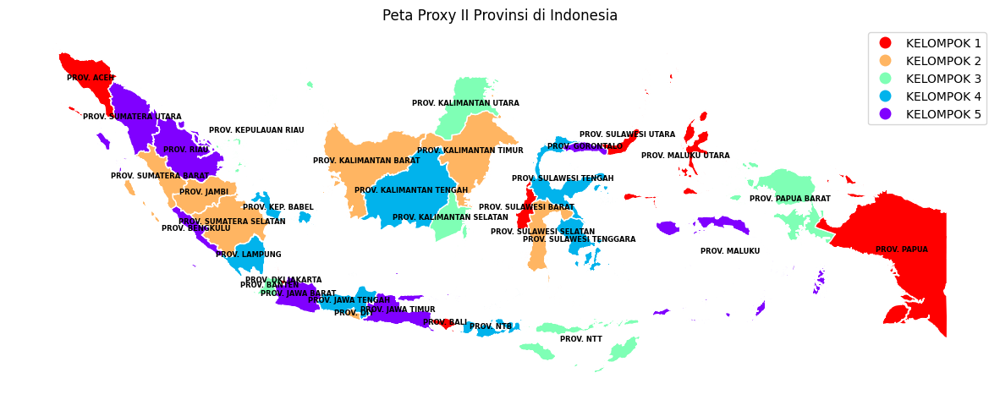

In [ ]:
generate_map_2() # PER TAHUN 2018 - 2022

## **MS-AR ARCHIEVE - PER 2021**

In [ ]:
def get_info_proxy_2():
  # # fetch the table from online spreadsheet
  # url_proxy = "https://docs.google.com/spreadsheets/d/1WA4NocpklIeakdIFQFAEV2FBItGCNiR7E1HS2QKN_bc/gviz/tq?tqx=out:csv&sheet=Final_Data"

  # untuk tahun 2021
  url_proxy = "https://docs.google.com/spreadsheets/d/1sJ_vRNbnEboPM2eu8GgxylPVaKD87rKpHGOJVjR8YjQ/gviz/tq?tqx=out:csv&sheet=Final"
  data = pd.read_csv(url_proxy)

  # drop out unwanted columns
  data_proxy = data[['Provinces ', 'Proxy_Variable_II', 'Quartile Classification']].copy()

  # set province column as index and drop the unused
  data_proxy = data_proxy.set_index(data_proxy['Provinces '])
  data_proxy = data_proxy.drop(columns='Provinces ')

  # rename the column
  data_proxy = data_proxy.rename(columns={
      'Provinces ' : 'Province',
      'Proxy_Variable_II' : 'Proxy Var II',
      'Quartile Classification' : 'Class'
      })

  return data_proxy

In [ ]:
def generate_msar():

  import warnings

  # Filter out specific warnings
  with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    warnings.simplefilter(action='ignore', category=DeprecationWarning)

  # list of provinces
  data_prov = get_daftar_provinsi()

  # initialize final dataframe
  final_df = pd.DataFrame(columns=['Low - Low', 'Low - High', 'High - Low', 'High - High', 'Duration (Low)', 'Duration (High)'])

  for index, row in data_prov.iterrows():
    province_name = row.iloc[0]

    # get timeseries proxy 1 for each daerah
    info_daerah = get_proxy_val_1(province_name)

    # build the MS-AR model for 2 regime (low-high risk)
    model = sm.tsa.MarkovAutoregression(info_daerah, k_regimes=2, order=1, switching_ar=True)

    if(province_name == "PROV. ACEH"):
      params = [0.02772746, 0.92772077, 0.62959613, 0.34813475, 0.04880235, 0.75270138, 0.02323013]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. BALI"):
      params = [0.06958277, 0.58896915, 0.1026239, 0.4735217, 0.61582375, 0.47305058, 0.84269822]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. BANTEN"):
      params = [0.02886365, 0.92574022, 0.12328465, 0.38821926, 0.83009005, 0.0302769, 0.79791538]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. BENGKULU"):
      params = [0.56253009, 0.13400457, 0.22914046, 0.88978664, 0.49157861, 0.24488756, 0.82605073]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. DIY"):
      params = [0.27912531, 0.99173754, 0.8761797, 0.28497583, 0.27126991, 0.03113454, 0.29118807]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. DKI JAKARTA"):
      params = [0.77541046, 0.85386933, 0.10107046, 0.56816269, 0.23742135, 0.98798703, 0.98181085]
      result = model.fit(start_params=params)
    # elif(province_name == "PROV. GORONTALO"): # USING DEFAULT PARAMETER
    elif(province_name == "PROV. JAMBI"):
      params = [0.6073391, 0.28882039, 0.76216142, 0.92262622, 0.57900489, 0.34949631, 0.73734612]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. JAWA BARAT"):
      params = [0.73254871, 0.32440621, 0.93803654, 0.70639507, 0.08984079, 0.77746444, 0.92139063]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. JAWA TENGAH"):
      params = [0.73254871, 0.32440621, 0.93803654, 0.70639507, 0.08984079, 0.77746444, 0.92139063]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. JAWA TIMUR"):
      params = [0.2563286, 0.40672614, 0.8560623, 0.72904769, 0.80831152, 0.48603889, 0.64504789]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KALIMANTAN BARAT"):
      params = [0.65088755, 0.48650398, 0.42437781, 0.26481948, 0.70703149, 0.20029241, 0.7550076]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KALIMANTAN SELATAN"):
      params = [0.17212342, 0.96875194, 0.62094249, 0.34989834, 0.79865251, 0.62110082, 0.07640746]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KALIMANTAN TENGAH"):
      params = [0.93413328, 0.91381254, 0.57693609, 0.4630356, 0.63804851, 0.45664281, 0.20107035]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KALIMANTAN TIMUR"):
      params = [0.94976164, 0.71892068, 0.39030459, 0.56077177, 0.71618146, 0.64528322, 0.8122563]
      result = model.fit(start_params=params)
    # elif(province_name == "PROV. KALIMANTAN UTARA"): # USING DEFAULT PARAMETER
    elif(province_name == "PROV. KEP. BABEL"):
      params = [0.46561726, 0.20819359, 0.46470855, 0.46642768, 0.08941814, 0.85040401, 0.35933561]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. KEPULAUAN RIAU"):
      params = [0.607418, 0.99336199, 0.6613137, 0.24155241, 0.64137363, 0.15924026, 0.61834375]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. LAMPUNG"):
      params = [0.26097844, 0.2707939, 0.98001475, 0.90735954, 0.88438279, 0.23530287, 0.5430957]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. MALUKU"):
      params = [0.26097844, 0.2707939, 0.98001475, 0.90735954, 0.88438279, 0.23530287, 0.5430957]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. MALUKU UTARA"):
      params = [0.72723277, 0.2208089, 0.49297018, 0.19182149, 0.58732119, 0.27347205, 0.65077613]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. NTB"):
      params = [0.85465036, 0.5971552, 0.73152023, 0.23420626, 0.97300529, 0.22534665, 0.09480023]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. NTT"):
      params = [0.20825119, 0.95333596, 0.81464642, 0.34736142, 0.56693919, 0.64573981, 0.61431988]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. PAPUA"):
      params = [0.75441111, 0.75450084, 0.46119529, 0.91454781, 0.84764985, 0.00787313, 0.33605897]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. PAPUA BARAT"):
      params = [0.37855579, 0.33281163, 0.98023386, 0.94619161, 0.59240564, 0.97657481, 0.26744635]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. RIAU"):
      params = [0.2393589, 0.14998467, 0.97329965, 0.50511963, 0.25926618, 0.52946104, 0.86689297]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SULAWESI BARAT"):
      params =[0.01785852, 0.97441102, 0.03226673, 0.99340458, 0.79821712, 0.08593268, 0.47585436]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SULAWESI SELATAN"):
      params = [0.17072579, 0.79858166, 0.69185038, 0.67539364, 0.04101764, 0.82690641, 0.92567844]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SULAWESI TENGAH"):
      params = [0.17072579, 0.79858166, 0.69185038, 0.67539364, 0.04101764, 0.82690641, 0.92567844]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SULAWESI TENGGARA"):
      params = [0.33272415, 0.66126184, 0.09088233, 0.57088842, 0.29694318, 0.53641043, 0.36060806]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SULAWESI UTARA"):
      params = [0.79456888, 0.15628936, 0.08961856, 0.17617757, 0.5803622, 0.99205199, 0.6598502]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SUMATERA BARAT"):
      params = [0.21188718, 0.27812949, 0.1908767, 0.64045524, 0.2151614, 0.44836088, 0.15485052]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SUMATERA SELATAN"):
      params = [0.09651418, 0.16430991, 0.18397294, 0.40849391, 0.32069763, 0.84114051, 0.18486059]
      result = model.fit(start_params=params)
    elif(province_name == "PROV. SUMATERA UTARA"):
      params = [0.80318816, 0.947684, 0.59494092, 0.50994323, 0.00745552, 0.94035481, 0.66190779]
      result = model.fit(start_params=params)
    else:
      result = model.fit()

    # print(result.summary())

    # record the regime transition probabilities
    transition_matrix = get_regime_trans(model, result)

    # record the regime duration
    risk_durations = result.expected_durations

    # merge the dataset
    final_df = assign_values(final_df, transition_matrix, risk_durations)

  final_df['Province'] = data_prov

  return final_df

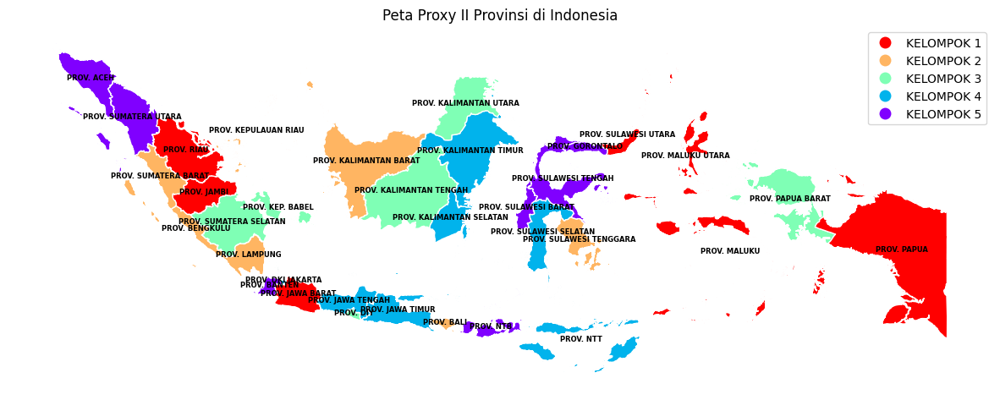

In [ ]:
generate_map_2() # PER TAHUN 2018 - 2021